# Load Packages

In [8]:
import os
import pandas as pd
import re
import numpy as np
import netCDF4 as nc
from PIL import Image
import datetime 
import imageio
import os 
import matplotlib.pyplot as plt
import math
import xarray as xr
import calplot

# Load S2 Data (csv format)

In [2]:
sites_data_s2 = pd.read_csv("~data/sites_data_s2_grid_index_updated.csv")
sites_data_s2.shape

In [3]:
sites_data_s2.shape

(134225838, 12)

In [4]:
sites_data_2_ = sites_data_s2.dropna(subset=['CHL', 'TUR', 'SPM'], how='all')
sites_data_2_.shape

(134225838, 12)

In [7]:
sites_data_s2_unique = sites_data_2_[['time', 'site']].drop_duplicates()
sites_data_s2_unique

,time,site
0,2020-01-04,ukh1303-10400
1356,2020-01-12,ukh1303-10400
2712,2020-01-19,ukh1303-10400
4068,2020-01-27,ukh1303-10400
5424,2020-01-29,ukh1303-10400
...,...,...
134219708,2022-12-09,ukh1303-10650
134220934,2022-12-14,ukh1303-10650
134222160,2022-12-24,ukh1303-10650
134223386,2022-12-27,ukh1303-10650


# Load S3 Data (csv format)

In [3]:
sites_data_s3 = pd.read_csv("~data/sites_data_15x15.csv")
sites_data_s3.shape

(106038000, 12)

In [4]:
sites_data_s3_ = sites_data_s3.dropna(subset=sites_data_s3.columns[[4,5,7,8,9,10]], how='all')
sites_data_s3_.shape

(24689254, 12)

In [12]:
sites_data_s3_unique = sites_data_s3_[['time', 'site']].drop_duplicates()
sites_data_s3_unique

,time,site
763,2020-01-01,ukc1202-06300
986,2020-01-01,ukc1202-06400
1211,2020-01-01,ukc1202-06500
1449,2020-01-01,ukc1202-06600
1687,2020-01-01,ukc1202-06650
...,...,...
105843609,2022-12-29,ukk4306-22900
105843833,2022-12-29,ukk4306-23000
105844084,2022-12-29,ukk4307-33800
105844320,2022-12-29,ukk4307-33900


# Load S3 Data (NetCDF Format)
CHL data from https://data.marine.copernicus.eu/product/OCEANCOLOUR_ATL_BGC_L3_MY_009_113/download?dataset=cmems_obs-oc_atl_bgc-plankton_my_l3-multi-1km_P1D_202303 

In [2]:
# ds = xr.open_dataset("~data/cmems_obs-oc_atl_bgc-plankton_my_l3-multi-1km_P1D_1691157822303.nc") # 26/7/2023, CHL
ds_chl = xr.open_dataset("~data/cmems_obs-oc_atl_bgc-plankton_my_l3-multi-1km_P1D_1691160929337.nc") # 17/7/2023, CHL
ds_bbp_cdm = xr.open_dataset("~data/cmems_obs-oc_atl_bgc-optics_my_l3-multi-1km_P1D_1691418421694.nc") # 17/7/2023, BBP & CDM
ds_kd490_spm_zsd = xr.open_dataset("~data/cmems_obs-oc_atl_bgc-transp_my_l3-multi-1km_P1D_1691418702936.nc") # 17/7/2023, KD490 & SPM & ZSD

In [18]:
ds_kd490_spm_zsd

<xarray.Dataset>
Dimensions:  (time: 1, lat: 1207, lon: 1551)
Coordinates:
  * lon      (lon) float32 -12.87 -12.86 -12.85 -12.84 ... 3.255 3.266 3.276
  * time     (time) datetime64[ns] 2023-07-17
  * lat      (lat) float32 60.62 60.61 60.6 60.59 ... 48.09 48.08 48.07 48.06
Data variables:
    SPM      (time, lat, lon) float32 ...
    KD490    (time, lat, lon) float32 ...
    ZSD      (time, lat, lon) float32 ...
Attributes: (12/92)
    FROM_ORIGINAL_FILE__lon_step:                     0.010416667
    keywords:                                         EARTH SCIENCE > OCEANS ...
    cmems_product_id:                                 OCEANCOLOUR_ATL_BGC_L3_...
    FROM_ORIGINAL_FILE__lat_step:                     0.010416667
    grid_mapping:                                     Equirectangular
    title:                                            cmems_obs-oc_atl_bgc-tr...
    ...                                               ...
    FROM_ORIGINAL_FILE__westernmost_longitude:        -46.0
    geospatial_vertical_positive:                     up
    date_created:                                     2023-08-06T07:36:57Z
    nb_valid_bins:                                    10793459
    pct_valid_bins:                                   43.15273603818677
    _CoordSysBuilder:                                 ucar.nc2.dataset.conv.C...

In [84]:
# non_missing_vals = np.count_nonzero(~np.isnan(ds['CHL'][0, :, :].data))
# print(f'Proportion of non missing values: {non_missing_vals}/{1145*1318}')

Proportion of non missing values: 612532/1509110


# 2D Plots

## Load Site Labels

In [6]:
sites_df = pd.read_csv('~data/site.csv')
sites = [[row['label'], row['lat'], row['long']] for index, row in sites_df.iterrows()]
sites[:10]

[['Ainsdale', 53.60792741, -3.063987798],
 ['Allonby', 54.76803625, -3.434625292],
 ['Allonby South', 54.74396018, -3.456453603],
 ['Amble Links', 55.32565184, -1.552400659],
 ['Anderby', 53.25977424, 0.325519541],
 ["Anstey's Cove (Torquay)", 50.47184615, -3.501089731],
 ['Babbacombe', 50.47907733, -3.509409069],
 ['Bamburgh Castle', 55.61096248, -1.707903477],
 ['Bantham', 50.2789762, -3.878799945],
 ['Beachlands Central', 50.78359334, -0.989275631]]

## Preliminary 2D Plots with data from 17/7/2023 

### Plotting Functions

In [8]:
# General Function
def site_local_plot(ds, site_name, variable, dimension = 10):
    '''
    ds: name of a .nc file, dataset for a single day of data (string)
    site_name: one of the 430 site names (string)
    variable: 'CHL', 'TUR', 'SPM' (string)
    dimension: creates dimension*2+1 square plot (integer)
    '''
    lat = float(sites_df[sites_df['label'] == site_name]['lat'])
    lon = float(sites_df[sites_df['label'] == site_name]['long'])
    
    lats = ds['lat'][:].data
    lons = ds['lon'][:].data
    
    lat_index = np.argmin(np.abs(lats - lat))
    lon_index = np.argmin(np.abs(lons - lon))
    
    i = dimension
    arr = ds[f'{variable}'][0,lat_index-i:lat_index+i+1,lon_index-i:lon_index+i+1].data
    
    plt.imshow(arr, cmap='viridis', interpolation='nearest')
    
    # Add highlighted point of Site Location
    plt.scatter(i, i, s=100, marker='o', facecolors='r')
    
    # Plot colorbar
    plt.colorbar()
    
    # Changing Ticks to match latitude and longitude
    new_xticks = [round(lons[j], 3) for j in np.arange(lon_index-i, lon_index+i+1)][::5]
    plt.xticks(range(len(new_xticks)*5)[::5], new_xticks)
    new_yticks = [round(lats[j], 3) for j in np.arange(lat_index-i, lat_index+i+1)][::5]
    plt.yticks(range(len(new_yticks)*5)[::5], new_yticks)
    
    # Add Title
    plt.title(f'{site_name}, {variable}')
    
    # Change Background colour to black
    plt.rcParams['axes.facecolor'] = 'black'

In [9]:
def plot_all_sites(ds, feature):
    fig, axs = plt.subplots(nrows=108, ncols=4, figsize=(25, 500))
    site_names = sites_df['label']

    for i, ax in enumerate(axs.flatten()):
        if i < 430:
            site_local_plot(ds, site_names[i], feature, 7)
            plt.sca(ax)
            plt.xticks([])
            plt.yticks([])
            ax.set_facecolor('black')
        else:
            ax.axis('off')
            
    plt.subplots_adjust(wspace=0.2, hspace=0.6)
    plt.show()

### CHL

In [10]:
plot_all_sites(ds_chl, 'CHL')

/var/folders/30/yf_8fbts0tx6rpv150kb_b3m0000gn/T/ipykernel_13013/3916389375.py:9: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  lat = float(sites_df[sites_df['label'] == site_name]['lat'])
/var/folders/30/yf_8fbts0tx6rpv150kb_b3m0000gn/T/ipykernel_13013/3916389375.py:10: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  lon = float(sites_df[sites_df['label'] == site_name]['long'])


### BBP

In [ ]:
plot_all_sites(ds_bbp_cdm, 'BBP')

/var/folders/30/yf_8fbts0tx6rpv150kb_b3m0000gn/T/ipykernel_13013/3916389375.py:9: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  lat = float(sites_df[sites_df['label'] == site_name]['lat'])
/var/folders/30/yf_8fbts0tx6rpv150kb_b3m0000gn/T/ipykernel_13013/3916389375.py:10: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  lon = float(sites_df[sites_df['label'] == site_name]['long'])


### CDM

In [14]:
plot_all_sites(ds_bbp_cdm, 'CDM')

/var/folders/30/yf_8fbts0tx6rpv150kb_b3m0000gn/T/ipykernel_13013/3916389375.py:9: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  lat = float(sites_df[sites_df['label'] == site_name]['lat'])
/var/folders/30/yf_8fbts0tx6rpv150kb_b3m0000gn/T/ipykernel_13013/3916389375.py:10: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  lon = float(sites_df[sites_df['label'] == site_name]['long'])


### KD490

In [22]:
plot_all_sites(ds_kd490_spm_zsd, 'KD490')

/var/folders/30/yf_8fbts0tx6rpv150kb_b3m0000gn/T/ipykernel_13013/3916389375.py:9: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  lat = float(sites_df[sites_df['label'] == site_name]['lat'])
/var/folders/30/yf_8fbts0tx6rpv150kb_b3m0000gn/T/ipykernel_13013/3916389375.py:10: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  lon = float(sites_df[sites_df['label'] == site_name]['long'])


### SPM

In [23]:
plot_all_sites(ds_kd490_spm_zsd, 'SPM')

/var/folders/30/yf_8fbts0tx6rpv150kb_b3m0000gn/T/ipykernel_13013/3916389375.py:9: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  lat = float(sites_df[sites_df['label'] == site_name]['lat'])
/var/folders/30/yf_8fbts0tx6rpv150kb_b3m0000gn/T/ipykernel_13013/3916389375.py:10: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  lon = float(sites_df[sites_df['label'] == site_name]['long'])


### ZSD

In [17]:
plot_all_sites(ds_kd490_spm_zsd, 'ZSD')

/var/folders/30/yf_8fbts0tx6rpv150kb_b3m0000gn/T/ipykernel_13013/3916389375.py:9: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  lat = float(sites_df[sites_df['label'] == site_name]['lat'])
/var/folders/30/yf_8fbts0tx6rpv150kb_b3m0000gn/T/ipykernel_13013/3916389375.py:10: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  lon = float(sites_df[sites_df['label'] == site_name]['long'])


## Plots Comparing two Datasets

In [90]:
# Function to Calculate Comparison 
def comparison_plot(ds1, ds2, site_name, variable, dimension = 5):
    '''
    Assumes that lat_index and lon_index snaps the lat and lon point to the same grid across datasets
    '''
    lat = float(sites_df[sites_df['label'] == site_name]['lat'])
    lon = float(sites_df[sites_df['label'] == site_name]['long'])
    
    # First dataset
    lats = ds1['lat'][:].data
    lons = ds1['lon'][:].data
    
    lat_index = np.argmin(np.abs(lats - lat))
    lon_index = np.argmin(np.abs(lons - lon))
    
    i = dimension
    arr1 = ds1[f'{variable}'][0,lat_index-i:lat_index+i+1,lon_index-i:lon_index+i+1].data
    
    # Second dataset
    lats = ds2['lat'][:].data
    lons = ds2['lon'][:].data
    
    lat_index = np.argmin(np.abs(lats - lat))
    lon_index = np.argmin(np.abs(lons - lon))
    
    i = dimension
    arr2 = ds2[f'{variable}'][0,lat_index-i:lat_index+i+1,lon_index-i:lon_index+i+1].data
    
    # Mask for when the arrays have the same values
    mask_same = np.logical_xor(np.isnan(arr1), np.isnan(arr2))
    mask_same = np.logical_not(mask_same)
    
    # Mask for when the arrays have the same values
    mask_same = np.logical_xor(np.isnan(arr1), np.isnan(arr2))
    mask_same = np.logical_not(mask_same)

    # Plot
    plt.imshow(mask_same, cmap='Set1')
    
    # Colorbar
    plt.colorbar()

    # Changing Ticks to match latitude and longitude
    new_xticks = [round(lons[j], 3) for j in np.arange(lon_index-i, lon_index+i+1)][::5]
    plt.xticks(range(len(new_xticks)*5)[::5], new_xticks)
    new_yticks = [round(lats[j], 3) for j in np.arange(lat_index-i, lat_index+i+1)][::5]
    plt.yticks(range(len(new_yticks)*5)[::5], new_yticks)

    # Add Title
    plt.title(f'{site_name}, {variable}')

In [94]:
# Load Second Dataset
# data from 26/07/2023
ds26 = nc.Dataset("~data/cmems_obs-oc_atl_bgc-plankton_my_l3-multi-1km_P1D_1691157822303.nc")

# data from 14/03/2023
ds14 = nc.Dataset("~data/cmems_obs-oc_atl_bgc-plankton_my_l3-multi-1km_P1D_1691162049216.nc")

/var/folders/30/yf_8fbts0tx6rpv150kb_b3m0000gn/T/ipykernel_7786/2320999897.py:6: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  lat = float(sites_df[sites_df['label'] == site_name]['lat'])
/var/folders/30/yf_8fbts0tx6rpv150kb_b3m0000gn/T/ipykernel_7786/2320999897.py:7: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  lon = float(sites_df[sites_df['label'] == site_name]['long'])


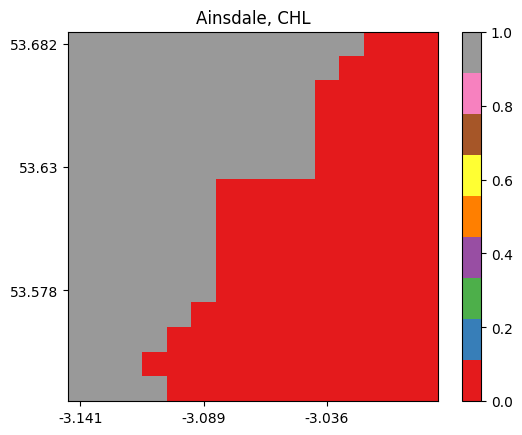

In [96]:
site = sites_df['label'][0]
comparison_plot(ds, ds14, site, 'CHL', 7)

In [97]:
%%time
fig, axs = plt.subplots(nrows=108, ncols=4, figsize=(25, 500))
site_names = sites_df['label']

for i, ax in enumerate(axs.flatten()):
    if i < 430:
        comparison_plot(ds, ds14, site_names[i], 'CHL', 7)
        plt.sca(ax)
        plt.xticks([])
        plt.yticks([])
        ax.set_facecolor('black')
    else:
        ax.axis('off')
        
plt.subplots_adjust(wspace=0.2, hspace=0.6)
plt.show()

/var/folders/30/yf_8fbts0tx6rpv150kb_b3m0000gn/T/ipykernel_7786/2320999897.py:6: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  lat = float(sites_df[sites_df['label'] == site_name]['lat'])
/var/folders/30/yf_8fbts0tx6rpv150kb_b3m0000gn/T/ipykernel_7786/2320999897.py:7: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  lon = float(sites_df[sites_df['label'] == site_name]['long'])


CPU times: user 24.3 s, sys: 914 ms, total: 25.2 s
Wall time: 25.7 s


# Missing Values

In [5]:
unique_pairs = sites_data_s3_.groupby('time')['site'].nunique()
percentage_list = [[index, value] for index, value in unique_pairs.items()]

In [6]:
pct = pd.DataFrame(percentage_list, columns = ['time','Percentage'])
pct['time'] = pd.to_datetime(pct['time'])
pct = pct.set_index('time')

(<Figure size 3000x1300 with 4 Axes>,
 array([<Axes: ylabel='2020'>, <Axes: ylabel='2021'>,
        <Axes: ylabel='2022'>], dtype=object))

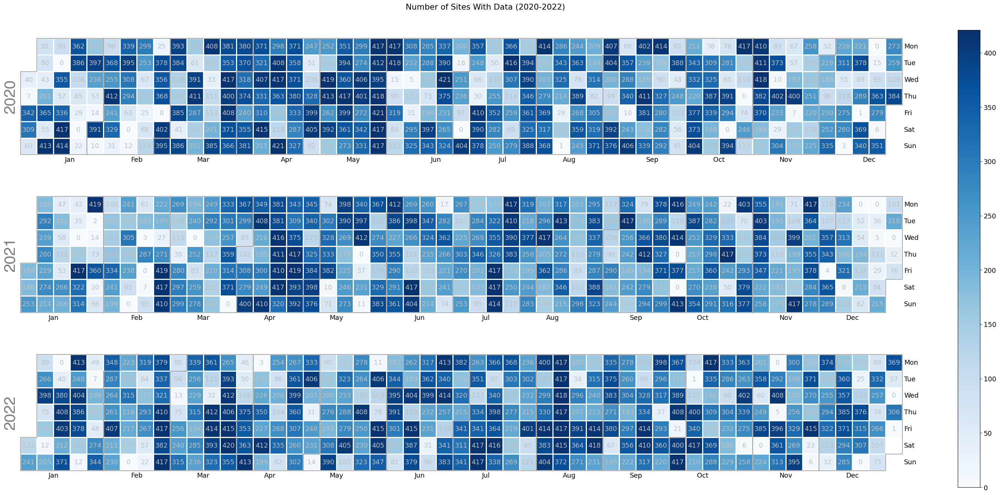

In [9]:
plt.rcParams['font.size'] = '13'

calplot.calplot(data = pct['Percentage'], how = 'sum', cmap = 'Blues', yearlabels = True,
                figsize = (30, 13), textformat='{:.0f}', textcolor = 'silver', fillcolor='w', 
                suptitle = "Number of Sites With Data (2020-2022)")